# Densidad Poblacional

*Realizamos el cálculo del número de frailejones y la densidad poblacional para los modelos de red multicapa y VGG16 como se muestra a continuación*

## Red Multicapa

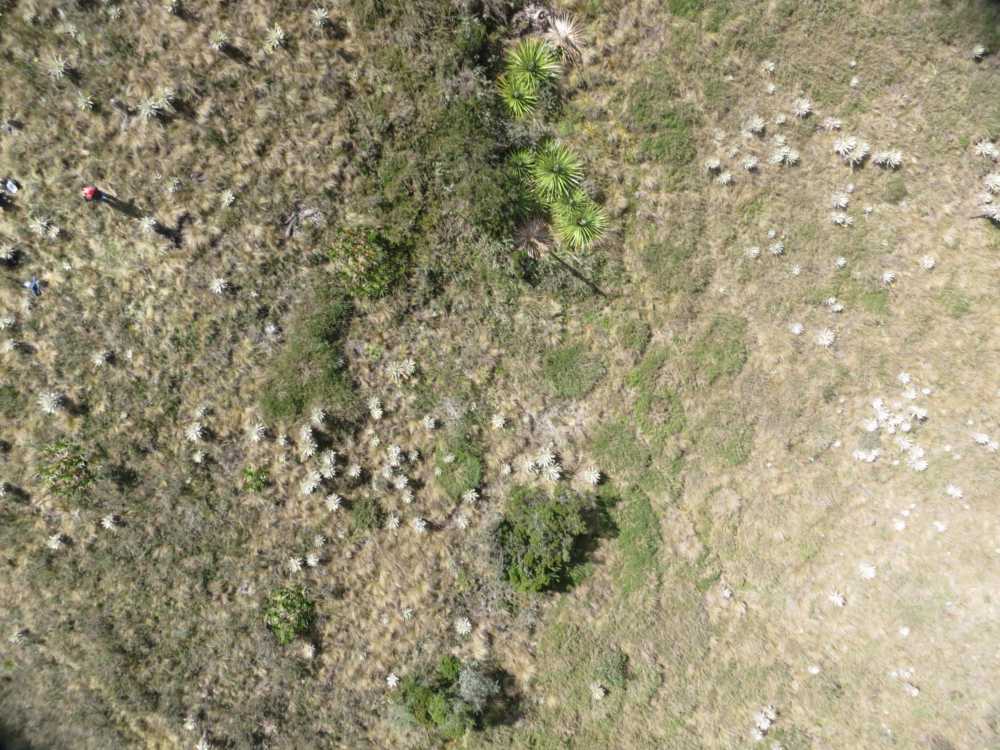

In [2]:
#Importamos la imagen de la prueba cualitativa
from tensorflow.keras.utils import load_img
import urllib
import matplotlib.pyplot as plt

urllib.request.urlretrieve('https://github.com/sergiomora03/AdvancedTopicsAnalytics/blob/main/notebooks/img/IMG_3451.JPG?raw=true', 'IMG_3451.JPG')
img = load_img('IMG_3451.JPG')
img

In [3]:
#Cargamos el modelo al notebook 
from tensorflow.keras.models import load_model
red_multicapa = load_model('modelo_Red_Multicapa.keras')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


C:\Users\ASUS RYZEN\AppData\Local\Temp\ipykernel_8760\3268212633.py:31: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pred_P = int(red_multicapa.predict(vec.T) > 0.5)  # 1 si es frailejón, 0 si no


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━

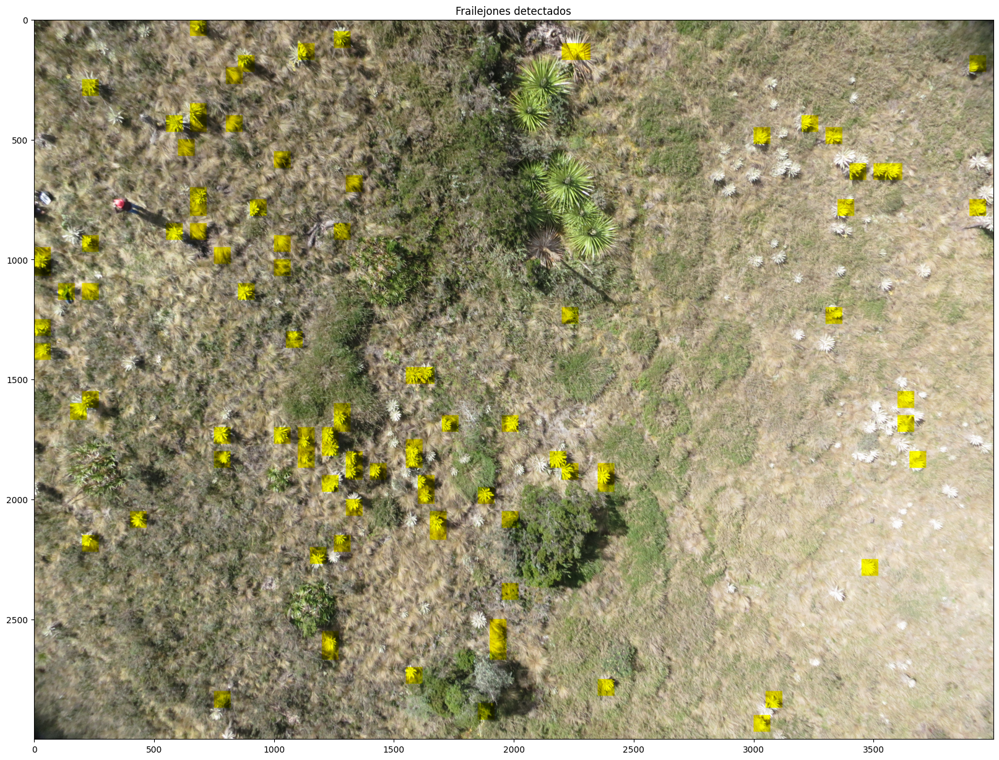

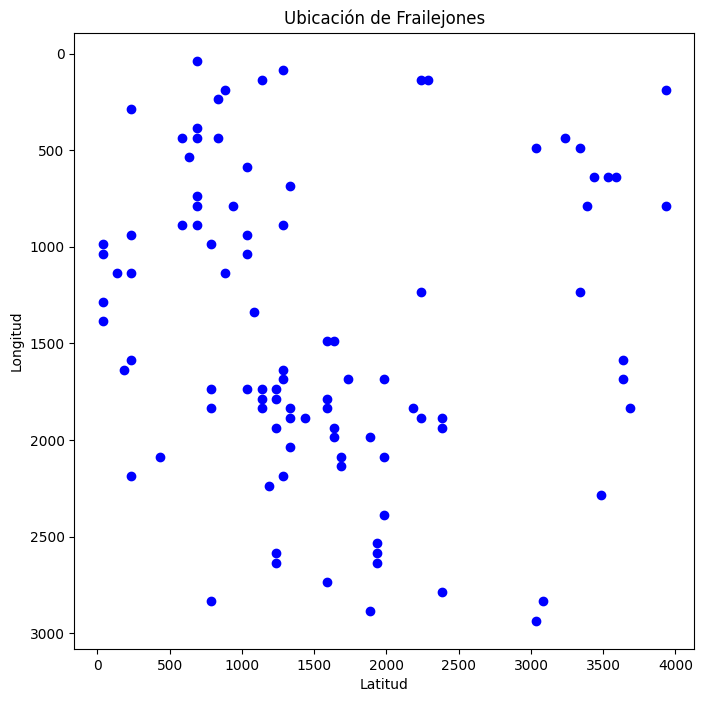

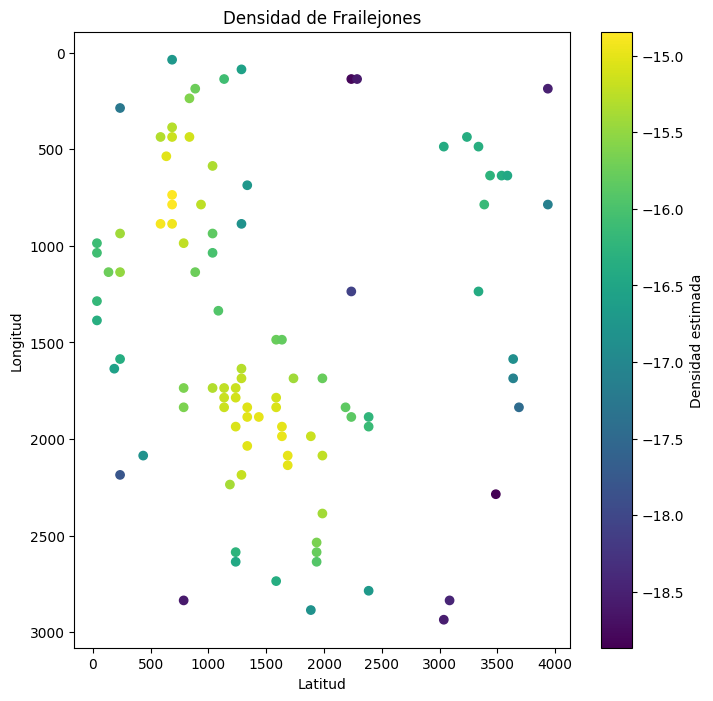

Número total de frailejones detectados: 97


In [4]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture

# Convertir la imagen a un array de numpy
x = np.array(img)
x2 = x.copy()

# Array para guardar coordenadas
frailejon_coords = []

# Dimensiones de la imagen
ni = x.shape[0] - 50
mi = x.shape[1] - 50

# Iniciar variables
f1 = 0
f2 = 70

# Loop para recorrer la imagen en bloques
for i in range(1, ni, 50):
    c1 = 0
    c2 = 70
    for j in range(1, mi, 50):
        subi = x[f1:f2, c1:c2, :]
        subi2 = np.ndarray.flatten(subi).T / 255.
        ns = subi2.shape[0]
        vec = subi2.reshape((ns, 1))

        # Predicción del modelo
        pred_P = int(red_multicapa.predict(vec.T) > 0.5)  # 1 si es frailejón, 0 si no

        # Si se detecta un frailejón
        if pred_P == 1:
            x2[f1:f2, c1:c2, 2] = 0  
            # Guardar las coordenadas del centro del bloque
            # Usamos 35 para centrar el punto en el bloque
            frailejon_coords.append([i + 35, j + 35])

        #Revisar el siguiente bloque
        c1 += 50
        c2 += 50

    f1 += 50
    f2 += 50

#Prueba cualitativa - Frailejones detectados
plt.figure(figsize=(20, 20))
plt.imshow(x2)
plt.title('Frailejones detectados')
plt.show()

# Convertir las coordenadas a un array de numpy para hacer el scatter plot
frailejon_coords = np.array(frailejon_coords)

# Graficar scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], color='blue')  # Intercambiar los ejes para alinearlos
plt.gca().invert_yaxis()  # Invertir el eje Y para que coincida con la imagen
plt.title('Ubicación de Frailejones')
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

# Calcular densidad usando GMM
gmm = GaussianMixture(n_components=3, covariance_type='full')
gmm.fit(frailejon_coords)

# Obtener las densidades estimadas
densidades = gmm.score_samples(frailejon_coords)

# Grafico de la densidad
plt.figure(figsize=(8, 8))
plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], c=densidades, cmap='viridis')  # Intercambiar los ejes
plt.gca().invert_yaxis()  # Invertir el eje Y
plt.colorbar(label='Densidad estimada')
plt.title('Densidad de Frailejones')
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

#Número de frailejones detectados
num_frailejones = len(frailejon_coords)
print(f'Número total de frailejones detectados: {num_frailejones}')

# VGG16

In [5]:
#Cargamos el modelo al notebook 
from tensorflow.keras.models import load_model
model = load_model('vgg16.keras')

c:\Users\ASUS RYZEN\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\saving\saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 6 variables whereas the saved optimizer has 10 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.mixture import GaussianMixture

# Convertir la imagen a un array de numpy
x = np.array(img)
x2 = x.copy()

# Array para guardar coordenadas
frailejon_coords = []

ni = x.shape[0] - 50
mi = x.shape[1] - 50

f1 = 0
f2 = 70

# Loop para recorrer la imagen en bloques
for i in range(1, ni, 50):
    c1 = 0
    c2 = 70
    for j in range(1, mi, 50):
        vec = x[f1:f2, c1:c2, :]
        vec = vec.reshape(1, 70, 70, 3)
        vec = tf.convert_to_tensor(vec)
        vec = tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True)(vec)
        vec = tf.keras.applications.resnet50.preprocess_input(vec)

        # Predicción del modelo
        pred_P = int(model.predict(vec) > 0.65)

        # # 1 si es frailejón, 0 si no
        if pred_P == 1:
            x2[f1:f2, c1:c2, 2] = 0  
            # Guardar las coordenadas del centro del bloque
            # Usamos 35 para centrar el punto en el bloque
            frailejon_coords.append([i + 35, j + 35])

        #Revisar el siguiente bloque
        c1 += 50
        c2 += 50

    f1 += 50
    f2 += 50

#Número de frailejones detectados
num_frailejones = len(frailejon_coords)
print(f'Número total de frailejones detectados: {num_frailejones}')

#Prueba cualitativa - Frailejones detectados
plt.figure(figsize=(20, 20))
plt.imshow(x2)
plt.title('Frailejones detectados')
plt.show()

# Convertir las coordenadas a un array de numpy para hacer el scatter plot
frailejon_coords = np.array(frailejon_coords)

# Graficar scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], color='blue')  # Intercambiar los ejes para alinearlos
plt.gca().invert_yaxis()  # Invertir el eje Y para que coincida con la imagen
plt.title('Ubicación de Frailejones')
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

# Calcular densidad usando GMM
gmm = GaussianMixture(n_components=3, covariance_type='full')
gmm.fit(frailejon_coords)

# Obtener las densidades estimadas
densidades = gmm.score_samples(frailejon_coords)

# Graficar las ubicaciones de los frailejones con la densidad estimada
plt.figure(figsize=(8, 8))
plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], c=densidades, cmap='viridis')  # Intercambiar los ejes
plt.gca().invert_yaxis()  # Invertir el eje Y
plt.colorbar(label='Densidad estimada')
plt.title('Densidad de Frailejones')
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()